<a href="https://colab.research.google.com/github/pearlchompunoot/CrimePrediction/blob/main/crime.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:


import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


In [ ]:
data = pd.read_csv('Crime_Data_from_2020_to_Present.csv')

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1005198 entries, 0 to 1005197
Data columns (total 28 columns):
 #   Column          Non-Null Count    Dtype  
---  ------          --------------    -----  
 0   DR_NO           1005198 non-null  int64  
 1   Date Rptd       1005198 non-null  object 
 2   DATE OCC        1005198 non-null  object 
 3   TIME OCC        1005198 non-null  int64  
 4   AREA            1005198 non-null  int64  
 5   AREA NAME       1005198 non-null  object 
 6   Rpt Dist No     1005198 non-null  int64  
 7   Part 1-2        1005198 non-null  int64  
 8   Crm Cd          1005198 non-null  int64  
 9   Crm Cd Desc     1005198 non-null  object 
 10  Mocodes         853438 non-null   object 
 11  Vict Age        1005198 non-null  int64  
 12  Vict Sex        860416 non-null   object 
 13  Vict Descent    860404 non-null   object 
 14  Premis Cd       1005182 non-null  float64
 15  Premis Desc     1004610 non-null  object 
 16  Weapon Used Cd  327280 non-null   fl

# Group Crm Cd Desc

## Goal:
Use existing data (excluding Crm Cd Desc) to predict Crime Group

(From Crm Cd Desc, there are hundreds of crime, we group them into categories of crimes. Then, let's see what can predict it)

In [ ]:

crmcddesc_counts = data['Crm Cd Desc'].value_counts()
crmcddesc_counts


,count
Crm Cd Desc,
VEHICLE - STOLEN,115247
BATTERY - SIMPLE ASSAULT,74847
BURGLARY FROM VEHICLE,63518
THEFT OF IDENTITY,62539
"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS)",61094
...,...
FIREARMS EMERGENCY PROTECTIVE ORDER (FIREARMS EPO),5
FIREARMS RESTRAINING ORDER (FIREARMS RO),4
DISHONEST EMPLOYEE ATTEMPTED THEFT,4


In [ ]:

print(f"\nCrm Cd Desc unique values:\n{data['Crm Cd Desc'].unique()}")



Crm Cd Desc unique values:
['VEHICLE - STOLEN' 'BURGLARY FROM VEHICLE' 'BIKE - STOLEN'
 'SHOPLIFTING-GRAND THEFT ($950.01 & OVER)' 'ARSON' 'BURGLARY' 'PIMPING'
 'PANDERING' 'OTHER MISCELLANEOUS CRIME'
 'VANDALISM - MISDEAMEANOR ($399 OR UNDER)'
 'INTIMATE PARTNER - SIMPLE ASSAULT' 'ROBBERY'
 'THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LIVESTK,PROD'
 'ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT' 'THEFT OF IDENTITY'
 'BATTERY - SIMPLE ASSAULT' 'SHOPLIFTING - PETTY THEFT ($950 & UNDER)'
 'BUNCO, GRAND THEFT' 'VIOLATION OF COURT ORDER'
 'VIOLATION OF RESTRAINING ORDER' 'THEFT PLAIN - PETTY ($950 & UNDER)'
 'VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS)'
 'RAPE, FORCIBLE' 'THEFT FROM MOTOR VEHICLE - GRAND ($950.01 AND OVER)'
 'TRESPASSING' 'VEHICLE - ATTEMPT STOLEN' 'RESISTING ARREST'
 'EMBEZZLEMENT, GRAND THEFT ($950.01 & OVER)'
 'BURGLARY FROM VEHICLE, ATTEMPTED'
 'LETTERS, LEWD  -  TELEPHONE CALLS, LEWD'
 'CRIMINAL THREATS - NO WEAPON DISPLAYED'
 'SEX OFFENDER REGISTRANT O

In [ ]:
import pandas as pd


def group_crime_description(description):
    """
    Groups the crime description into broader categories.
    """
    description = str(description).upper()
    if 'THEFT' in description or 'SHOPLIFTING' in description or 'BUNCO' in description or \
       'EMBEZZLEMENT' in description or 'PICKPOCKET' in description or 'PURSE SNATCHING' in description or \
       'TILL TAP' in description or 'CREDIT CARDS, FRAUD USE' in description or \
       'DISHONEST EMPLOYEE' in description or 'THEFT, COIN MACHINE' in description or \
       'DEFRAUDING INNKEEPER' in description or 'GRAND THEFT / INSURANCE FRAUD' in description:
        return 'Theft'
    elif 'BURGLARY' in description:
        return 'Burglary'
    elif 'ASSAULT' in description or 'BATTERY' in description:
        return 'Assault/Battery'
    elif 'RAPE' in description or 'ORAL COPULATION' in description or 'INDECENT EXPOSURE' in description or \
         'SEX OFFENDER' in description or 'SEXUAL PENETRATION' in description or \
         'LEWD CONDUCT' in description or 'PEEPING TOM' in description or \
         'SODOMY' in description or 'CHILD PORNOGRAPHY' in description or \
         'LEWD/LASCIVIOUS ACTS WITH CHILD' in description or 'PIMPING' in description or \
         'PANDERING' in description or 'HUMAN TRAFFICKING - COMMERCIAL SEX ACTS' in description or \
         'SEX,UNLAWFUL' in description:
        return 'Sex Crimes'
    elif 'VANDALISM' in description:
        return 'Vandalism'
    elif 'WEAPON' in description or 'FIREARMS' in description or 'SHOTS FIRED' in description or 'BOMBING' in description or 'BRANDISH' in description:
        return 'Weapons Related'
    elif 'THREAT' in description or 'STALKING' in description or 'LEWD  -  TELEPHONE CALLS' in description or 'BOMB SCARE' in description:
        return 'Threats/Harassment'
    elif 'CHILD' in description and ('ABUSE' in description or 'NEGLECT' in description or 'ANNOYING' in description or 'STEALING' in description or 'ABANDONMENT' in description or 'CRM AGNST CHLD'):
        return 'Crimes Against Children'
    elif 'VIOLATION OF COURT ORDER' in description or 'VIOLATION OF RESTRAINING ORDER' in description or \
         'RESISTING ARREST' in description or 'CONTEMPT OF COURT' in description or \
         'FALSE POLICE REPORT' in description or 'VIOLATION OF TEMPORARY RESTRAINING ORDER' in description:
        return 'Obstruction of Justice/Legal Violations'
    elif 'VEHICLE - STOLEN' in description or 'VEHICLE - ATTEMPT STOLEN' in description or 'DWOC' in description or 'BOAT - STOLEN' in description:
        return 'Vehicle Related Crime'
    elif 'TRESPASSING' in description or 'DISTURBING THE PEACE' in description or \
         'FAILURE TO YIELD' in description or 'DOCUMENT FORGERY' in description or \
         'KIDNAPPING' in description or 'CRIMINAL HOMICIDE' in description or \
         'EXTORTION' in description or 'FALSE IMPRISONMENT' in description or \
         'UNAUTHORIZED COMPUTER ACCESS' in description or 'COUNTERFEIT' in description or \
         'CRUELTY TO ANIMALS' in description or 'PROWLER' in description or \
         'ILLEGAL DUMPING' in description or 'MANSLAUGHTER, NEGLIGENT' in description or \
         'RECKLESS DRIVING' in description or 'LYNCHING' in description or \
         'HUMAN TRAFFICKING - INVOLUNTARY SERVITUDE' in description or 'CONTRIBUTING' in description or \
         'BRIBERY' in description or 'CONSPIRACY' in description or 'DISRUPT SCHOOL' in description:
        return 'Other Crimes'
    else:
        return 'Other Miscellaneous Crime' # Catch-all for anything not explicitly grouped

# Apply the grouping function to create a new column 'Crime Group'
data['Crime Group'] = data['Crm Cd Desc'].apply(group_crime_description)

# You can then inspect the unique values of the new column:
print(data['Crime Group'].unique())

['Vehicle Related Crime' 'Burglary' 'Other Miscellaneous Crime' 'Theft'
 'Sex Crimes' 'Vandalism' 'Assault/Battery'
 'Obstruction of Justice/Legal Violations' 'Other Crimes'
 'Threats/Harassment' 'Weapons Related' 'Crimes Against Children']


In [ ]:
data = data.drop(['Crm Cd Desc'], axis=1)

In [ ]:

pd.options.display.max_rows = 100  # This will display all rows when printing the DataFrame
pd.options.display.max_columns = None  # This will display all rows when printing the DataFrame




In [ ]:
data.head()

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,Crime Group
0,190326475,03/01/2020 12:00:00 AM,03/01/2020 12:00:00 AM,2130,7,Wilshire,784,1,510,NaN,0,M,O,101.0,STREET,NaN,NaN,AA,Adult Arrest,510.0,998.0,NaN,NaN,1900 S LONGWOOD AV,NaN,34.0375,-118.3506,Vehicle Related Crime
1,200106753,02/09/2020 12:00:00 AM,02/08/2020 12:00:00 AM,1800,1,Central,182,1,330,1822 1402 0344,47,M,O,128.0,BUS STOP/LAYOVER (ALSO QUERY 124),NaN,NaN,IC,Invest Cont,330.0,998.0,NaN,NaN,1000 S FLOWER ST,NaN,34.0444,-118.2628,Burglary
2,200320258,11/11/2020 12:00:00 AM,11/04/2020 12:00:00 AM,1700,3,Southwest,356,1,480,0344 1251,19,X,X,502.0,"MULTI-UNIT DWELLING (APARTMENT, DUPLEX, ETC)",NaN,NaN,IC,Invest Cont,480.0,NaN,NaN,NaN,1400 W 37TH ST,NaN,34.0210,-118.3002,Other Miscellaneous Crime
3,200907217,05/10/2023 12:00:00 AM,03/10/2020 12:00:00 AM,2037,9,Van Nuys,964,1,343,0325 1501,19,M,O,405.0,CLOTHING STORE,NaN,NaN,IC,Invest Cont,343.0,NaN,NaN,NaN,14000 RIVERSIDE DR,NaN,34.1576,-118.4387,Theft
4,200412582,09/09/2020 12:00:00 AM,09/09/2020 12:00:00 AM,630,4,Hollenbeck,413,1,510,NaN,0,NaN,NaN,101.0,STREET,NaN,NaN,IC,Invest Cont,510.0,NaN,NaN,NaN,200 E AVENUE 28,NaN,34.0820,-118.2130,Vehicle Related Crime


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1005198 entries, 0 to 1005197
Data columns (total 28 columns):
 #   Column          Non-Null Count    Dtype  
---  ------          --------------    -----  
 0   DR_NO           1005198 non-null  int64  
 1   Date Rptd       1005198 non-null  object 
 2   DATE OCC        1005198 non-null  object 
 3   TIME OCC        1005198 non-null  int64  
 4   AREA            1005198 non-null  int64  
 5   AREA NAME       1005198 non-null  object 
 6   Rpt Dist No     1005198 non-null  int64  
 7   Part 1-2        1005198 non-null  int64  
 8   Crm Cd          1005198 non-null  int64  
 9   Mocodes         853438 non-null   object 
 10  Vict Age        1005198 non-null  int64  
 11  Vict Sex        860416 non-null   object 
 12  Vict Descent    860404 non-null   object 
 13  Premis Cd       1005182 non-null  float64
 14  Premis Desc     1004610 non-null  object 
 15  Weapon Used Cd  327280 non-null   float64
 16  Weapon Desc     327280 non-null   ob

In [ ]:
data.columns

Index(['DR_NO', 'Date Rptd', 'DATE OCC', 'TIME OCC', 'AREA', 'AREA NAME',
       'Rpt Dist No', 'Part 1-2', 'Crm Cd', 'Mocodes', 'Vict Age', 'Vict Sex',
       'Vict Descent', 'Premis Cd', 'Premis Desc', 'Weapon Used Cd',
       'Weapon Desc', 'Status', 'Status Desc', 'Crm Cd 1', 'Crm Cd 2',
       'Crm Cd 3', 'Crm Cd 4', 'LOCATION', 'Cross Street', 'LAT', 'LON',
       'Crime Group'],
      dtype='object')

In [ ]:
# unique values of each col
for col in data.columns:
  print(f'{col}: {data[col].unique()}')


DR_NO: [190326475 200106753 200320258 ... 250504051 251604136 251904210]
Date Rptd: ['03/01/2020 12:00:00 AM' '02/09/2020 12:00:00 AM'
 '11/11/2020 12:00:00 AM' ... '02/01/2025 12:00:00 AM'
 '03/21/2025 12:00:00 AM' '01/25/2025 12:00:00 AM']
DATE OCC: ['03/01/2020 12:00:00 AM' '02/08/2020 12:00:00 AM'
 '11/04/2020 12:00:00 AM' ... '03/03/2025 12:00:00 AM'
 '01/03/2025 12:00:00 AM' '01/19/2025 12:00:00 AM']
TIME OCC: [2130 1800 1700 ...  559  818  841]
AREA: [ 7  1  3  9  4  2 13 11 12  6  5 10  8 15 14 17 19 18 20 16 21]
AREA NAME: ['Wilshire' 'Central' 'Southwest' 'Van Nuys' 'Hollenbeck' 'Rampart'
 'Newton' 'Northeast' '77th Street' 'Hollywood' 'Harbor' 'West Valley'
 'West LA' 'N Hollywood' 'Pacific' 'Devonshire' 'Mission' 'Southeast'
 'Olympic' 'Foothill' 'Topanga']
Rpt Dist No: [784 182 356 ... 672 709 902]
Part 1-2: [1 2]
Crm Cd: [510 330 480 343 648 310 805 806 946 745 626 210 341 230 354 624 442 662
 900 901 440 740 121 331 888 520 437 668 410 956 930 845 661 420 812 761
 320 75

# Data Dict


https://data.lacity.org/Public-Safety/Crime-Data-from-2020-to-Present/2nrs-mtv8/about_data

DR_NO - Division of Records Number: Official file number made up of a 2 digit year, area ID, and 5 digits.

DATE OCC - Date of crime occurrence(YYYY-MM-DD)

AREA - The LAPD has 21 Community Police Stations referred to as Geographic Areas within the department. These Geographic Areas are sequentially numbered from 1-21.

AREA NAME - The 21 Geographic Areas or Patrol Divisions are also given a name designation that references a landmark or the surrounding community that it is responsible for.

Rpt Dist No - Code that represents a sub-area within a Geographic Area.

Crm Cd - Indicates the crime committed.

Crm Cd Desc - Defines the Crime Code provided.

Vict Age - Indicates the age of the victim.

Vict Sex - F: Female M: Male X: Unknown

Vict Descent - Descent Code: A - Other Asian B - Black C - Chinese D - Cambodian F - Filipino G - Guamanian H - Hispanic/Latin/Mexican I - American Indian/Alaskan Native J - Japanese K - Korean L - Laotian O - Other P - Pacific Islander S - Samoan U - Hawaiian V - Vietnamese W - White X - Unknown Z - Asian Indian

Premis Cd - The type of structure, vehicle, or location where the crime took place.

Premis Desc - Defines the Premise Code provided.

Weapon Used Cd - The type of weapon used in the crime.

Weapon Desc - Defines the Weapon Used Code provided.

LOCATION - Street address of crime incident rounded to the nearest hundred block to maintain anonymity.

LAT - Latitude Coordinate.

LON - Longitude Coordinate.

ref https://medium.com/analytics-vidhya/los-angeles-crime-data-analysis-using-pandas-a68780d80a83

# Data Exploration

In [ ]:

statusdesc_counts = data['Status Desc'].value_counts()
statusdesc_counts


,count
Status Desc,
Invest Cont,803946
Adult Other,109255
Adult Arrest,86877
Juv Arrest,3249
Juv Other,1864
UNK,7


In [ ]:

weapondesc_counts = data['Weapon Desc'].value_counts()
weapondesc_counts


,count
Weapon Desc,
"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",174777
UNKNOWN WEAPON/OTHER WEAPON,36394
VERBAL THREAT,23848
HAND GUN,20186
SEMI-AUTOMATIC PISTOL,7267
KNIFE WITH BLADE 6INCHES OR LESS,6841
UNKNOWN FIREARM,6581
OTHER KNIFE,5880
MACE/PEPPER SPRAY,3730


In [ ]:
data.isnull().sum()

,0
DR_NO,0
Date Rptd,0
DATE OCC,0
TIME OCC,0
AREA,0
AREA NAME,0
Rpt Dist No,0
Part 1-2,0
Crm Cd,0
Mocodes,151760


In [ ]:
#  percentage of null of each column per whole data'

null_percentage = (data.isnull().sum() / len(data)) * 100

null_percentage


,0
DR_NO,0.000000
Date Rptd,0.000000
DATE OCC,0.000000
TIME OCC,0.000000
AREA,0.000000
AREA NAME,0.000000
Rpt Dist No,0.000000
Part 1-2,0.000000
Crm Cd,0.000000
Mocodes,15.097523


## Drop unrelated column

In [ ]:
data = data.drop(['DR_NO'], axis=1)

#Deal with null values

## Crm Cd 1 2 3 4

In [ ]:
# Crm Cd 1, Crm Cd 2, Crm Cd 3, Crm Cd 4 impute null with 0 (float)

data[['Crm Cd 1', 'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4']] = data[['Crm Cd 1', 'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4']].fillna(0.0)


## Vict Descent

In [ ]:
descent_by_area = data.groupby(['AREA', 'Vict Descent'], dropna=False)['Vict Descent'].size().unstack()

descent_by_area

Vict Descent,-,A,B,C,D,F,G,H,I,J,K,L,O,P,S,U,V,W,X,Z,NaN
AREA,,,,,,,,,,,,,,,,,,,,,
1,NaN,2061.0,13516.0,1019.0,23.0,514.0,8.0,17789.0,162.0,257.0,704.0,14.0,5981.0,49.0,7.0,18.0,202.0,12290.0,8975.0,121.0,5964.0
2,NaN,949.0,5290.0,141.0,1.0,310.0,3.0,17557.0,34.0,42.0,369.0,2.0,2398.0,13.0,NaN,7.0,41.0,6346.0,6385.0,7.0,6931.0
3,NaN,1315.0,16791.0,322.0,7.0,77.0,4.0,15208.0,201.0,57.0,133.0,3.0,2365.0,16.0,4.0,20.0,52.0,4834.0,7245.0,31.0,8826.0
4,NaN,433.0,1439.0,201.0,4.0,106.0,1.0,18833.0,29.0,46.0,125.0,3.0,804.0,7.0,2.0,6.0,47.0,3109.0,4521.0,5.0,7374.0
5,NaN,549.0,4059.0,96.0,4.0,183.0,1.0,14746.0,32.0,103.0,110.0,6.0,2392.0,10.0,12.0,3.0,39.0,6450.0,5267.0,3.0,7397.0
6,NaN,1206.0,6712.0,271.0,5.0,241.0,1.0,10193.0,72.0,92.0,194.0,4.0,4150.0,11.0,1.0,9.0,88.0,16178.0,7936.0,12.0,5054.0
7,NaN,1470.0,6422.0,276.0,2.0,254.0,6.0,8379.0,25.0,114.0,535.0,5.0,4729.0,8.0,4.0,9.0,58.0,13259.0,7133.0,39.0,5513.0
8,NaN,1585.0,2699.0,632.0,2.0,189.0,3.0,4529.0,41.0,215.0,258.0,2.0,5850.0,20.0,NaN,8.0,97.0,17881.0,7063.0,116.0,4541.0
9,1.0,752.0,3416.0,123.0,3.0,187.0,4.0,12474.0,24.0,35.0,93.0,1.0,4457.0,12.0,NaN,8.0,43.0,12092.0,2995.0,6.0,6157.0


In [ ]:
# impute Vict Descent null, "-" with "X" to indicate "Unknown" (as stated in data dictionary that X means unknown)


data['Vict Descent'] = data['Vict Descent'].fillna('X').replace('-', 'X')


## Vict Sex

In [ ]:

null_victsex = data[data['Vict Sex'].isnull()]
null_victsex


,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,Crime Group
4,09/09/2020 12:00:00 AM,09/09/2020 12:00:00 AM,630,4,Hollenbeck,413,1,510,NaN,0,NaN,X,101.0,STREET,NaN,NaN,IC,Invest Cont,510.0,0.0,0.0,0.0,200 E AVENUE 28,NaN,34.0820,-118.2130,Vehicle Related Crime
5,05/03/2020 12:00:00 AM,05/02/2020 12:00:00 AM,1800,2,Rampart,245,1,510,NaN,0,NaN,X,101.0,STREET,NaN,NaN,IC,Invest Cont,510.0,0.0,0.0,0.0,2500 W 4TH ST,NaN,34.0642,-118.2771,Vehicle Related Crime
7,03/27/2020 12:00:00 AM,03/27/2020 12:00:00 AM,1210,13,Newton,1333,1,510,NaN,0,NaN,X,101.0,STREET,NaN,NaN,IC,Invest Cont,510.0,0.0,0.0,0.0,3200 S SAN PEDRO ST,NaN,34.0170,-118.2643,Vehicle Related Crime
8,07/31/2020 12:00:00 AM,07/30/2020 12:00:00 AM,2030,11,Northeast,1161,1,510,NaN,0,NaN,X,101.0,STREET,NaN,NaN,AA,Adult Arrest,510.0,0.0,0.0,0.0,KENMORE ST,FOUNTAIN,34.0953,-118.2974,Vehicle Related Crime
9,12/04/2020 12:00:00 AM,12/03/2020 12:00:00 AM,2300,1,Central,105,1,510,NaN,0,NaN,X,101.0,STREET,NaN,NaN,IC,Invest Cont,510.0,0.0,0.0,0.0,400 SOLANO AV,NaN,34.0710,-118.2302,Vehicle Related Crime
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1005186,02/10/2025 12:00:00 AM,02/06/2025 12:00:00 AM,30,5,Harbor,523,1,341,NaN,0,NaN,X,101.0,STREET,NaN,NaN,IC,Invest Cont,341.0,0.0,0.0,0.0,2000 JOHN S GIBSON BL,NaN,33.7566,-118.2896,Theft
1005190,02/18/2025 12:00:00 AM,02/14/2025 12:00:00 AM,1200,3,Southwest,328,1,510,NaN,0,NaN,X,501.0,SINGLE FAMILY DWELLING,NaN,NaN,IC,Invest Cont,510.0,0.0,0.0,0.0,700 W 28TH ST,NaN,34.0270,-118.2794,Vehicle Related Crime
1005193,02/23/2025 12:00:00 AM,02/21/2025 12:00:00 AM,1530,3,Southwest,358,1,510,NaN,0,NaN,X,101.0,STREET,NaN,NaN,IC,Invest Cont,510.0,0.0,0.0,0.0,3600 MCCLINTOCK AV,NaN,34.0212,-118.2895,Vehicle Related Crime
1005194,02/20/2025 12:00:00 AM,02/13/2025 12:00:00 AM,2100,3,Southwest,325,1,522,NaN,0,NaN,X,108.0,PARKING LOT,NaN,NaN,IC,Invest Cont,522.0,0.0,0.0,0.0,2600 ELLENDALE PL,NaN,34.0307,-118.2923,Other Miscellaneous Crime


In [ ]:
# Impute null vict sex as X to indicate "Unknown" (stated in data dictionary that X means Unknown)

data['Vict Sex'] = data['Vict Sex'].fillna('X')


## Premis Cd and Premis Desc

In [ ]:
# rows where Premise Cd is null

null_premise_cd = data[data['Premis Cd'].isnull()]
null_premise_cd


,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,Crime Group
41704,03/16/2020 12:00:00 AM,03/16/2020 12:00:00 AM,1400,6,Hollywood,647,1,510,NaN,0,X,X,NaN,NaN,NaN,NaN,IC,Invest Cont,510.0,0.0,0.0,0.0,SUNSET BL,GOWER,34.0980,-118.3223,Vehicle Related Crime
158661,10/21/2020 12:00:00 AM,10/20/2020 12:00:00 AM,2000,19,Mission,1966,1,510,NaN,0,X,X,NaN,NaN,NaN,NaN,IC,Invest Cont,510.0,0.0,0.0,0.0,9400 VAN NUYS BL,NaN,34.2410,-118.4502,Vehicle Related Crime
342082,12/22/2021 12:00:00 AM,12/22/2021 12:00:00 AM,430,4,Hollenbeck,418,1,420,NaN,0,X,X,NaN,NaN,NaN,NaN,IC,Invest Cont,420.0,0.0,0.0,0.0,3900 VAN HORNE AV,NaN,34.0948,-118.1751,Theft
380953,03/27/2021 12:00:00 AM,03/27/2021 12:00:00 AM,1200,7,Wilshire,759,1,420,NaN,0,X,X,NaN,NaN,NaN,NaN,IC,Invest Cont,420.0,0.0,0.0,0.0,1200 WESTCHESTER PL,NaN,34.0472,-118.3189,Theft
387118,01/12/2021 12:00:00 AM,01/11/2021 12:00:00 AM,1400,14,Pacific,1428,2,946,NaN,0,X,X,NaN,NaN,NaN,NaN,IC,Invest Cont,946.0,0.0,0.0,0.0,3200 OVERLAND AV,NaN,34.0265,-118.4184,Other Miscellaneous Crime
503298,10/27/2022 12:00:00 AM,10/26/2022 12:00:00 AM,2100,16,Foothill,1651,1,520,NaN,0,X,X,NaN,NaN,NaN,NaN,IC,Invest Cont,520.0,0.0,0.0,0.0,9800 LAUREL CANYON BL,NaN,34.2482,-118.4209,Vehicle Related Crime
508545,01/02/2022 12:00:00 AM,01/02/2022 12:00:00 AM,1430,13,Newton,1395,1,520,NaN,0,X,X,NaN,NaN,NaN,NaN,IC,Invest Cont,520.0,0.0,0.0,0.0,400 E 68TH ST,NaN,33.9779,-118.2681,Vehicle Related Crime
540863,09/30/2022 12:00:00 AM,09/30/2022 12:00:00 AM,1700,18,Southeast,1871,1,420,NaN,0,X,X,NaN,NaN,NaN,NaN,IC,Invest Cont,420.0,0.0,0.0,0.0,14900 S MENLO AV,NaN,33.8964,-118.2892,Theft
647029,05/10/2023 12:00:00 AM,05/09/2023 12:00:00 AM,1825,11,Northeast,1177,1,420,NaN,0,X,X,NaN,NaN,NaN,NaN,IC,Invest Cont,420.0,0.0,0.0,0.0,2200 N FIGUEROA ST,NaN,34.0884,-118.2258,Theft
708849,10/03/2023 12:00:00 AM,10/01/2023 12:00:00 AM,700,10,West Valley,1004,2,626,NaN,57,F,W,NaN,NaN,NaN,NaN,AO,Adult Other,626.0,0.0,0.0,0.0,18300 ROSCOE BL,NaN,34.2208,-118.5317,Assault/Battery


In [ ]:
#rows where Premise Desc is null

null_premise_desc = data[data['Premis Desc'].isnull()]
null_premise_desc


,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,Crime Group
804,09/01/2020 12:00:00 AM,09/01/2020 12:00:00 AM,2030,13,Newton,1394,1,210,2018 1822 0432 1100 0344 0329 1402 1309,0,M,H,418.0,NaN,103.0,RIFLE,IC,Invest Cont,210.0,998.0,0.0,0.0,6500 S MAIN ST,NaN,33.9802,-118.2739,Other Miscellaneous Crime
1286,10/03/2020 12:00:00 AM,10/03/2020 12:00:00 AM,345,10,West Valley,1018,1,310,1202 0321 2018 1822 1609,0,M,W,418.0,NaN,NaN,NaN,IC,Invest Cont,310.0,0.0,0.0,0.0,7500 WOODLEY AV,NaN,34.2066,-118.4837,Burglary
3188,04/03/2020 12:00:00 AM,01/15/2020 12:00:00 AM,1640,1,Central,163,1,440,0907 0344 1822,0,X,X,418.0,NaN,NaN,NaN,AO,Adult Other,440.0,0.0,0.0,0.0,700 S BROADWAY,NaN,34.0452,-118.2534,Theft
4036,04/25/2020 12:00:00 AM,04/25/2020 12:00:00 AM,255,13,Newton,1303,1,310,2018 1402 0907 2024 1607 0329 0358 0344,0,X,X,418.0,NaN,NaN,NaN,AA,Adult Arrest,310.0,998.0,0.0,0.0,1200 PALOMA ST,NaN,34.0312,-118.2478,Burglary
4881,07/09/2020 12:00:00 AM,07/09/2020 12:00:00 AM,1020,5,Harbor,531,1,210,1236 2018 1402 1409 0344 0448 1272,0,X,X,418.0,NaN,400.0,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",IC,Invest Cont,210.0,998.0,0.0,0.0,25900 WESTERN AV,NaN,33.7879,-118.3075,Other Miscellaneous Crime
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
990431,07/07/2024 12:00:00 AM,07/07/2024 12:00:00 AM,2255,1,Central,132,2,888,0910 2004,0,X,X,973.0,NaN,NaN,NaN,IC,Invest Cont,888.0,0.0,0.0,0.0,200 S HOPE ST,NaN,34.0549,-118.2511,Other Crimes
990716,01/23/2024 12:00:00 AM,01/23/2024 12:00:00 AM,525,12,77th Street,1233,1,310,1402 1609 0329 1309 0342 1822 0216,0,X,X,418.0,NaN,NaN,NaN,IC,Invest Cont,310.0,0.0,0.0,0.0,6000 S WESTERN AV,NaN,33.9859,-118.3090,Burglary
996512,03/04/2024 12:00:00 AM,03/04/2024 12:00:00 AM,440,21,Topanga,2126,1,310,1420 1402 0397,0,M,W,256.0,NaN,500.0,UNKNOWN WEAPON/OTHER WEAPON,IC,Invest Cont,310.0,998.0,0.0,0.0,21300 DEERING CT,NaN,34.2156,-118.5956,Burglary
999809,01/23/2024 12:00:00 AM,01/23/2024 12:00:00 AM,330,15,N Hollywood,1549,1,310,1822 0325 0329 2018,0,X,X,256.0,NaN,NaN,NaN,IC,Invest Cont,310.0,0.0,0.0,0.0,10800 CHANDLER BL,NaN,34.1687,-118.3664,Burglary


In [ ]:
# for nulls premis desc where Premis Cd is not null, print out unique premis cd

# Filter out rows where 'Premis Cd' is not null and 'Premis Desc' is null
filtered_data = data[(data['Premis Cd'].notnull()) & (data['Premis Desc'].isnull())]

# Get the unique 'Premis Cd' values from the filtered data
unique_premis_cd = filtered_data['Premis Cd'].unique()

unique_premis_cd


array([418., 256., 974., 972., 973., 976., 975.])

In [ ]:
# for these premis cd 418., 256., 974., 972., 973., 976., 975.
# see if there are multiple premis desc unique values

premis_codes = [418, 256, 974, 972, 973, 976, 975]

for code in premis_codes:
  print(f"Distribution for Premis Code {code}:")
  subset = data[data['Premis Cd'] == code]
  print(subset['Premis Desc'].value_counts())
  print("-" * 20)


Distribution for Premis Code 418:
Series([], Name: count, dtype: int64)
--------------------
Distribution for Premis Code 256:
Series([], Name: count, dtype: int64)
--------------------
Distribution for Premis Code 974:
Series([], Name: count, dtype: int64)
--------------------
Distribution for Premis Code 972:
Series([], Name: count, dtype: int64)
--------------------
Distribution for Premis Code 973:
Series([], Name: count, dtype: int64)
--------------------
Distribution for Premis Code 976:
Series([], Name: count, dtype: int64)
--------------------
Distribution for Premis Code 975:
Series([], Name: count, dtype: int64)
--------------------


In [ ]:
# As there are not multiple unique values for premis desc,
# that means each code represent each distinct category,
# we just do not know its name
# Thus, for nulls premis desc where Premis Cd is not null, impute them with the Premis Cd value

# Iterate through rows where 'Premis Cd' is not null and 'Premis Desc' is null
for index, row in data[(data['Premis Cd'].notnull()) & (data['Premis Desc'].isnull())].iterrows():
    premis_cd = row['Premis Cd']
    # Impute 'Premis Desc' with the corresponding 'Premis Cd' value
    data.loc[index, 'Premis Desc'] = premis_cd


In [ ]:
# For the rest null of Premis Cd and Premis Desc, they are both unknown. Thus, impute with 0.0
# Impute null values in 'Premis Cd' with 0.0
data['Premis Cd'] = data['Premis Cd'].fillna(0.0).astype(float)

# Impute null values in 'Premis Desc' with 0.0
data['Premis Desc'] = data['Premis Desc'].fillna(0.0)


## Weapon Used Cd and Weapon Desc

In [ ]:

weapondesc_counts = data['Weapon Desc'].value_counts()
weapondesc_counts



,count
Weapon Desc,
"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",174777
UNKNOWN WEAPON/OTHER WEAPON,36394
VERBAL THREAT,23848
HAND GUN,20186
SEMI-AUTOMATIC PISTOL,7267
KNIFE WITH BLADE 6INCHES OR LESS,6841
UNKNOWN FIREARM,6581
OTHER KNIFE,5880
MACE/PEPPER SPRAY,3730


In [ ]:


# Replace null values in 'Weapon Desc' with 'UNKNOWN WEAPON/OTHER WEAPON'
data['Weapon Desc'] = data['Weapon Desc'].fillna('UNKNOWN WEAPON/OTHER WEAPON')




In [ ]:
# Where Weapon Desc = UNKNOWN WEAPON/OTHER WEAPON, print out Weapon Used Cd (codes)

# Filter for rows where 'Weapon Desc' is 'UNKNOWN WEAPON/OTHER WEAPON'
unknown_weapon_data = data[data['Weapon Desc'] == 'UNKNOWN WEAPON/OTHER WEAPON']

# Get the unique values of 'Weapon Used Cd' for these rows
unique_weapon_codes = unknown_weapon_data['Weapon Used Cd'].unique()

unique_weapon_codes


array([ nan, 500.])

In [ ]:
# we can see that the code for this category is 500.0
# Impute null values in 'Weapon Used Cd' with 500.0
data['Weapon Used Cd'] = data['Weapon Used Cd'].fillna(500.0).astype(float)


## Mocodes

Modus Operandi: Activities associated with the suspect in commission of the crime.

In [ ]:

# ## Mocodes
mocodes_counts = data['Mocodes'].value_counts()
print(mocodes_counts)




Mocodes
0344                             42200
0329                             21631
1822 0344                        14251
0325                             10278
0344 1822                         9841
                                 ...  
1402 0411 1822 1815 1251             1
0421 2204                            1
1259 0302 1251                       1
1100 1300 0450 0906 0371 1822        1
0913 1824 0416 0400 1259 2024        1
Name: count, Length: 310956, dtype: int64


In [ ]:


print(f"Number of null Mocodes: {data['Mocodes'].isnull().sum()}")


Number of null Mocodes: 151760


In [ ]:
151760/len(data)

0.1509752307505586

The proportion of null is large. Plus, we don't have much info about the code. Thus, try dropping it first.

In [ ]:
data = data.drop('Mocodes', axis=1)

## Status

In [ ]:
data[data['Status'].isnull()]

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,Crime Group
882208,241810568,06/08/2024 12:00:00 AM,05/24/2024 12:00:00 AM,1900,18,Southeast,1871,1,510,0,NaN,NaN,0.0,0.0,500.0,UNKNOWN WEAPON/OTHER WEAPON,NaN,UNK,510.0,NaN,NaN,NaN,13500 S FIGUEROA ST,NaN,33.9092,-118.2827,Vehicle Related Crime


In [ ]:
# prompt: Status Desc unique val


unique_status_desc = data['Status Desc'].unique()
print(f"Unique values in 'Status Desc':\n{unique_status_desc}")


Unique values in 'Status Desc':
['Adult Arrest' 'Invest Cont' 'Adult Other' 'Juv Arrest' 'Juv Other' 'UNK']


Status Desc of the null Status is 'UNK' which is different from other. Thus, we impute Status with 'UNK' as well to indicate this category.

In [ ]:

data['Status'] = data['Status'].fillna('UNK')


## Cross Street

In [ ]:

cross_street_counts = data['Cross Street'].value_counts()
cross_street_counts


,count
Cross Street,
BROADWAY,2487
FIGUEROA ST,1934
FIGUEROA,1646
VERMONT AV,1634
WESTERN AV,1491
...,...
S RAMPART BL,1
OXNARD BL,1
INVERNESS AV,1


In [ ]:

print(f"Number of null Cross Street: {data['Cross Street'].isnull().sum()}")

# Check the percentage of null values
null_cross_street_percentage = (data['Cross Street'].isnull().sum() / len(data)) * 100
print(f"Percentage of null Cross Street values: {null_cross_street_percentage:.2f}%")



Number of null Cross Street: 850955
Percentage of null Cross Street values: 84.66%



  Since there are a significant number of null values in the 'Cross Street' column,
 and considering its potential irrelevance to the crime prediction, we can consider dropping it.


In [ ]:

# Drop the 'Cross Street' column
data = data.drop('Cross Street', axis=1)


In [ ]:


data.isnull().sum()


,0
DR_NO,0
Date Rptd,0
DATE OCC,0
TIME OCC,0
AREA,0
AREA NAME,0
Rpt Dist No,0
Part 1-2,0
Crm Cd,0
Vict Age,0


# EDA

## Timing of crime

In [ ]:
data.columns

Index(['DR_NO', 'Date Rptd', 'DATE OCC', 'TIME OCC', 'AREA', 'AREA NAME',
       'Rpt Dist No', 'Part 1-2', 'Crm Cd', 'Vict Age', 'Vict Sex',
       'Vict Descent', 'Premis Cd', 'Premis Desc', 'Weapon Used Cd',
       'Weapon Desc', 'Status', 'Status Desc', 'Crm Cd 1', 'Crm Cd 2',
       'Crm Cd 3', 'Crm Cd 4', 'LOCATION', 'LAT', 'LON', 'Crime Group'],
      dtype='object')

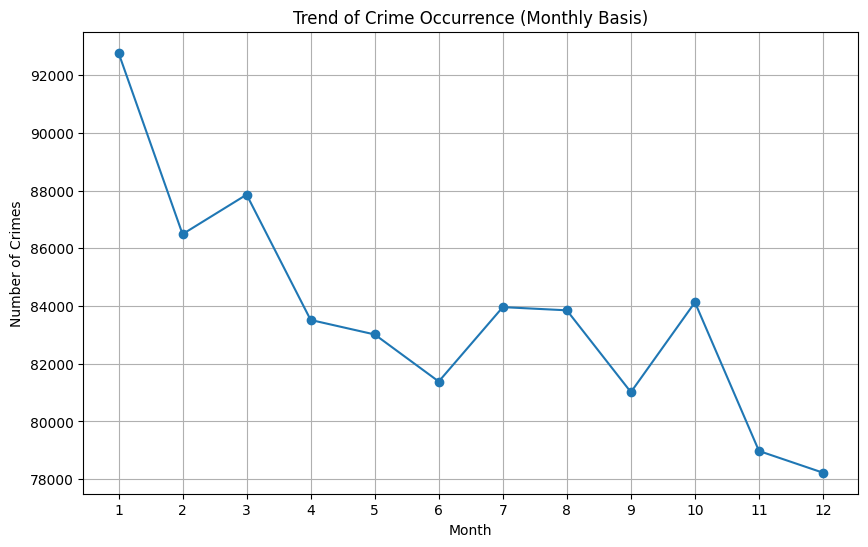

In [ ]:
# monthly basis

# Convert 'DATE OCC' to datetime objects
data['DATE OCC'] = pd.to_datetime(data['DATE OCC'])

# Extract the month from the 'DATE OCC' column
data['Month OCC'] = data['DATE OCC'].dt.month

# Group by month and count the number of crimes
monthly_crime_counts = data.groupby('Month OCC')['DATE OCC'].count()

# Create the line chart
plt.figure(figsize=(10, 6))
plt.plot(monthly_crime_counts.index, monthly_crime_counts.values, marker='o')
plt.title('Trend of Crime Occurrence (Monthly Basis)')
plt.xlabel('Month')
plt.ylabel('Number of Crimes')
plt.xticks(range(1, 13))  # Set x-axis ticks to represent months
plt.grid(True)
plt.show()


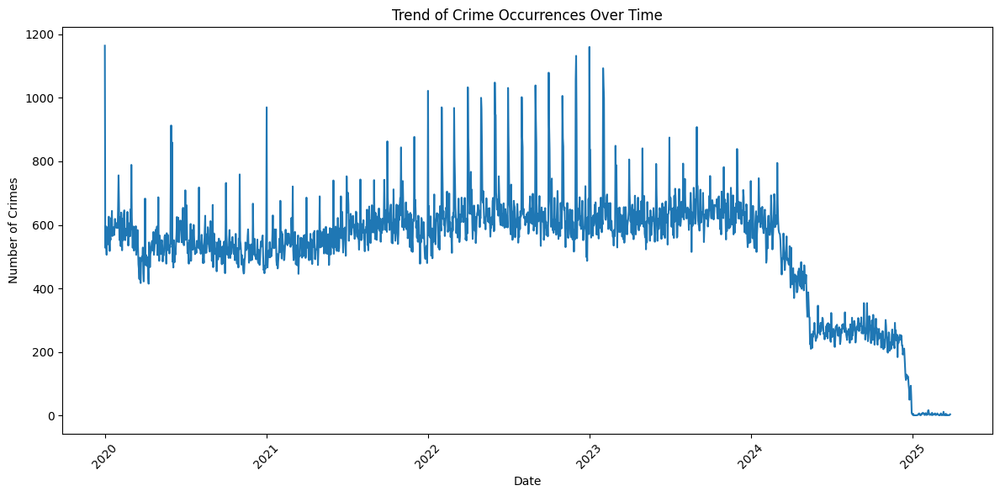

In [ ]:

# Convert 'DATE OCC' to datetime objects
data['DATE OCC'] = pd.to_datetime(data['DATE OCC'])

# Group data by date and count occurrences
crime_counts_by_date = data.groupby('DATE OCC')['DATE OCC'].count()

# Create the line chart
plt.figure(figsize=(12, 6))
plt.plot(crime_counts_by_date.index, crime_counts_by_date.values)
plt.xlabel('Date')
plt.ylabel('Number of Crimes')
plt.title('Trend of Crime Occurrences Over Time')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
data['TIME OCC'].unique()

array([2130, 1800, 1700, ...,  559,  818,  841])

There is a seasonal trend in crime occurrence, with a peak in the early months of the year (e.g., January to March) followed by a gradual decline towards the end of the year.

While the overall trend shows fluctuations in crime rates, there is a noticeable downward trend in recent years (2024-2025), indicating a potential decrease in crime occurrences.

## Location of Crime

ref: https://www.kaggle.com/code/sonawanelalitsunil/crime-trends-since-2020-ml-99-99

I got this code from the reference link above. It creates a heatmap to see density of crime occurrences in the places.

In [ ]:
import folium
from folium.plugins import HeatMap

map_center = [data['LAT'].mean(), data['LON'].mean()]
crime_map = folium.Map(location=map_center, zoom_start=10)
HeatMap(data=data[['LAT', 'LON']].dropna()).add_to(crime_map)
crime_map

# Modelling

In [ ]:
data.columns

Index(['DR_NO', 'Date Rptd', 'DATE OCC', 'TIME OCC', 'AREA', 'AREA NAME',
       'Rpt Dist No', 'Part 1-2', 'Crm Cd', 'Vict Age', 'Vict Sex',
       'Vict Descent', 'Premis Cd', 'Premis Desc', 'Weapon Used Cd',
       'Weapon Desc', 'Status', 'Status Desc', 'Crm Cd 1', 'Crm Cd 2',
       'Crm Cd 3', 'Crm Cd 4', 'LOCATION', 'LAT', 'LON', 'Crime Group',
       'Month OCC'],
      dtype='object')

try Random Forests model

In [ ]:
y = data['Crime Group']
X = data.drop(['Crime Group','Date Rptd', 'DATE OCC', 'AREA NAME','Part 1-2','Crm Cd',
              'Status Desc','Weapon Desc' ,'Premis Desc', 'LAT', 'LON'], axis=1)

In [ ]:

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder

# Convert categorical columns to numerical using Label Encoding
label_encoders = {}
for column in X.columns:
    if X[column].dtype == 'object':
        label_encoders[column] = LabelEncoder()
        X[column] = label_encoders[column].fit_transform(X[column])

# Encode the target variable 'y'
label_encoder_y = LabelEncoder()
y = label_encoder_y.fit_transform(y)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train a Random Forest Classifier
rf_classifier = RandomForestClassifier(random_state=42)
rf_classifier.fit(X_train, y_train)

# Make predictions on the test set
y_pred = rf_classifier.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy of the Random Forest Classifier: {accuracy}")


Accuracy of the Random Forest Classifier: 0.9956227616394747


In [ ]:
from sklearn.metrics import classification_report

classification_report = classification_report(y_test, y_pred)
print("Classification Report of random forest:")
print(classification_report)

Classification Report of random forest:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     40681
           1       1.00      1.00      1.00     25112
           2       0.98      0.86      0.91       552
           3       0.99      0.99      0.99      4588
           4       0.97      0.97      0.97      6401
           5       0.99      0.99      0.99     12086
           6       0.95      0.97      0.96      2469
           7       1.00      1.00      1.00     58168
           8       0.99      0.96      0.97      2058
           9       1.00      1.00      1.00     17138
          10       1.00      1.00      1.00     24069
          11       0.99      0.99      0.99      7718

    accuracy                           1.00    201040
   macro avg       0.99      0.98      0.98    201040
weighted avg       1.00      1.00      1.00    201040



           Feature    Importance
10        Crm Cd 1  6.191145e-01
8   Weapon Used Cd  1.557429e-01
5         Vict Sex  5.448495e-02
6     Vict Descent  3.952166e-02
7        Premis Cd  3.527644e-02
4         Vict Age  2.543699e-02
9           Status  1.819409e-02
1         TIME OCC  9.545879e-03
11        Crm Cd 2  9.020037e-03
0            DR_NO  8.520338e-03
14        LOCATION  8.369600e-03
3      Rpt Dist No  8.019472e-03
2             AREA  4.321751e-03
15       Month OCC  4.119662e-03
12        Crm Cd 3  3.113042e-04
13        Crm Cd 4  4.143319e-07


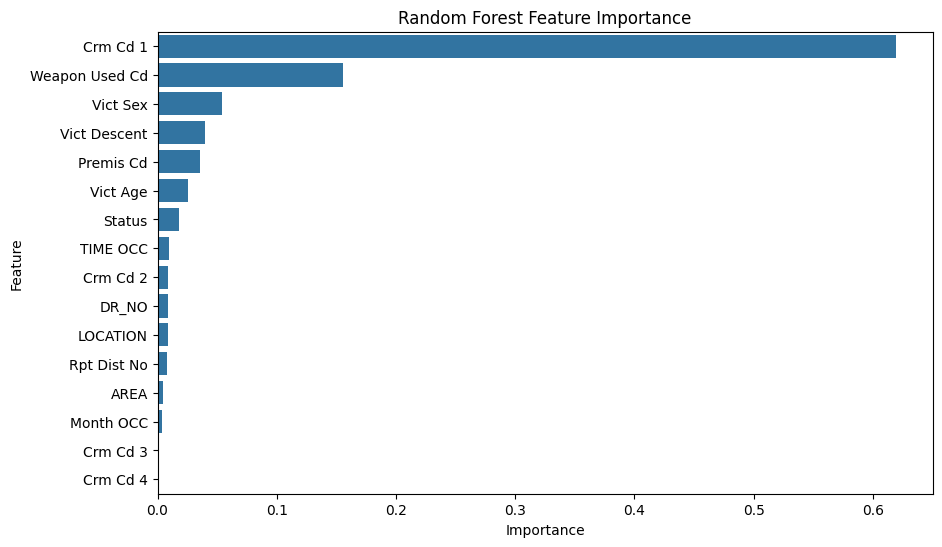

In [ ]:
# rf feature importance

importances = rf_classifier.feature_importances_
feature_names = X.columns

importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False)

print(importance_df)
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title('Random Forest Feature Importance')
plt.show()


In [ ]:
# prompt: use decision tree to predict y

from sklearn.tree import DecisionTreeClassifier

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train a Decision Tree Classifier
dt_classifier = DecisionTreeClassifier(random_state=42)
dt_classifier.fit(X_train, y_train)

# Make predictions on the test set
y_pred = dt_classifier.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy of the Decision Tree Classifier: {accuracy}")



Accuracy of the Decision Tree Classifier: 0.9996717071229606


In [ ]:
from sklearn.metrics import classification_report

# Use a different variable name to avoid conflict
classification_rep = classification_report(y_test, y_pred)
print("Classification Report of decision tree:")
print(classification_rep)

Classification Report of decision tree:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     40681
           1       1.00      1.00      1.00     25112
           2       1.00      1.00      1.00       552
           3       1.00      1.00      1.00      4588
           4       1.00      1.00      1.00      6401
           5       1.00      1.00      1.00     12086
           6       1.00      0.99      1.00      2469
           7       1.00      1.00      1.00     58168
           8       1.00      1.00      1.00      2058
           9       1.00      1.00      1.00     17138
          10       1.00      1.00      1.00     24069
          11       1.00      1.00      1.00      7718

    accuracy                           1.00    201040
   macro avg       1.00      1.00      1.00    201040
weighted avg       1.00      1.00      1.00    201040



           Feature  Importance
10        Crm Cd 1    0.818572
8   Weapon Used Cd    0.177226
11        Crm Cd 2    0.003920
7        Premis Cd    0.000054
12        Crm Cd 3    0.000043
1         TIME OCC    0.000027
14        LOCATION    0.000026
0            DR_NO    0.000025
4         Vict Age    0.000023
3      Rpt Dist No    0.000022
6     Vict Descent    0.000018
2             AREA    0.000015
15       Month OCC    0.000012
5         Vict Sex    0.000010
9           Status    0.000007
13        Crm Cd 4    0.000000


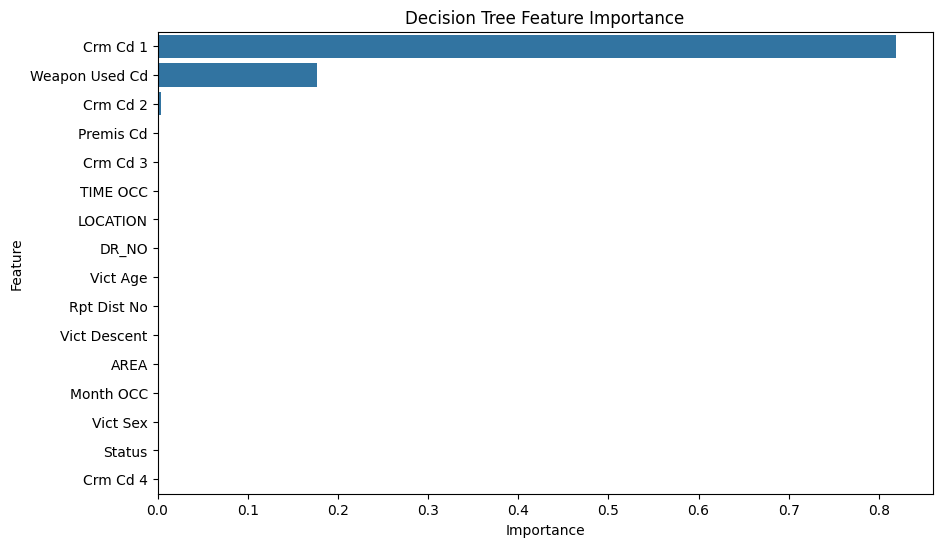

In [ ]:

# Feature Importance
importances = dt_classifier.feature_importances_
feature_names = X.columns

importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False)

print(importance_df)
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title('Decision Tree Feature Importance')
plt.show()

## Use only 'Crm Cd 1', 'Weapon Used Cd' as features

In [ ]:

# Use only 'Crm Cd 1' and 'Weapon Used Cd' to predict 'Crime Group'
y = data['Crime Group']
X = data[['Crm Cd 1', 'Weapon Used Cd']]

# Convert categorical columns to numerical using Label Encoding
label_encoders = {}
for column in X.columns:
    if X[column].dtype == 'object':
        label_encoders[column] = LabelEncoder()
        X[column] = label_encoders[column].fit_transform(X[column])

# Encode the target variable 'y'
label_encoder_y = LabelEncoder()
y = label_encoder_y.fit_transform(y)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train a Random Forest Classifier
rf_classifier = RandomForestClassifier(random_state=42)
rf_classifier.fit(X_train, y_train)

# Make predictions on the test set
y_pred = rf_classifier.predict(X_test)

# Evaluate the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy of the Random Forest Classifier (using only 'Crm Cd 1' and 'Weapon Used Cd'): {accuracy}")

classification_rep = classification_report(y_test, y_pred)
print("Classification Report:")
print(classification_rep)


Accuracy of the Random Forest Classifier (using only 'Crm Cd 1' and 'Weapon Used Cd'): 0.9981148030242738
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     40681
           1       1.00      1.00      1.00     25112
           2       1.00      0.99      1.00       552
           3       1.00      1.00      1.00      4588
           4       1.00      1.00      1.00      6401
           5       0.99      1.00      0.99     12086
           6       1.00      0.95      0.97      2469
           7       1.00      1.00      1.00     58168
           8       1.00      1.00      1.00      2058
           9       1.00      1.00      1.00     17138
          10       1.00      1.00      1.00     24069
          11       1.00      0.99      0.99      7718

    accuracy                           1.00    201040
   macro avg       1.00      0.99      1.00    201040
weighted avg       1.00      1.00      1.00    201040



#Check if there is data leakage?
Can we tell crime group directly from Crm Cd 1 or Weapon Used Cd

In [ ]:
# prompt: for each Crime Group, print out Crm Cd 1

# Group data by 'Crime Group'
crime_groups = data.groupby('Crime Group')

# Iterate through each crime group
for crime_group, group_data in crime_groups:
    # Print the 'Crm Cd 1' values for the current crime group
    print(f"Crime Group: {crime_group}")
    print(group_data['Crm Cd 1'].unique())
    print("-" * 20)


Crime Group: Assault/Battery
[626. 230. 624. 623. 627. 625. 236. 231. 235. 860. 434. 622. 437. 237.
 760. 762. 661. 438. 763.  nan]
--------------------
Crime Group: Burglary
[330. 310. 410. 320. 510. 521. 522.  nan 420.]
--------------------
Crime Group: Crimes Against Children
[922. 237. 813. 870. 762. 900. 625. 624.]
--------------------
Crime Group: Obstruction of Justice/Legal Violations
[900. 901. 437. 903. 902. 439. 436.]
--------------------
Crime Group: Other Crimes
[888. 661. 886. 890. 649. 920. 940. 434. 910. 110. 660. 943. 933. 626.
 949. 113. 438. 436. 624. 921. 860. 954. 942. 944. 880. 435. 812. 627.
 822.  nan 662. 900. 745. 625. 805.]
--------------------
Crime Group: Other Miscellaneous Crime
[480. 648. 946. 210. 237. 522. 220. 812. 651. 647. 624. 627. 762. 652.
 485. 760. 626. 865. 625. 353. 330. 924. 840. 948. 884. 341. 440. 830.
 649. 331. 432. 882. 441. 926. 453.]
--------------------
Crime Group: Sex Crimes
[805. 806. 121. 845. 820. 850. 815. 810. 822. 122. 762. 9

In [ ]:
# prompt: for each Crime Group, print out weapon cd

# Group data by 'Crime Group'
crime_groups = data.groupby('Crime Group')

# Iterate through each crime group
for crime_group, group_data in crime_groups:
    # Print the 'Weapon Used Cd' values for the current crime group
    print(f"Crime Group: {crime_group}")
    print(group_data['Weapon Used Cd'].unique())
    print("-" * 20)


Crime Group: Assault/Battery
[400. 201. 215. 102. 500. 311. 109. 106. 200. 312. 114. 205. 218. 306.
 207. 212. 302. 515. 308. 101. 513. 223. 204. 307. 216. 512. 103. 304.
 503. 104. 305. 301. 219. 303. 107. 511. 310. 105. 508. 203. 221. 309.
 506. 122. 206. 120. 505. 211. 514. 217. 507. 112. 502. 516. 510. 213.
 210. 115. 110. 208. 202. 113. 123. 509. 118. 214. 220. 108. 209. 501.
 111. 117. 504. 116. 300. 125. 124.]
--------------------
Crime Group: Burglary
[500. 400. 302. 312. 306. 218. 514. 310. 112. 311. 308. 307. 203. 304.
 102. 305. 219. 207. 223. 511. 211. 221. 201. 113. 204. 114. 125. 210.
 200. 205. 515. 107. 106. 309. 109. 101. 216. 108. 300. 104. 122. 506.
 208. 215. 103. 509. 212. 512.]
--------------------
Crime Group: Crimes Against Children
[500. 400. 307. 109. 205. 511. 200. 103. 102. 515. 308. 311. 107. 101.
 207. 310. 114. 106. 208. 312. 301. 122.]
--------------------
Crime Group: Obstruction of Justice/Legal Violations
[500. 400. 511. 307. 515. 310. 311. 212. 200. 

In [ ]:
# prompt: for each Crime Group, print out weapon cd and frequenct

# Group data by 'Crime Group'
crime_groups = data.groupby('Crime Group')

# Iterate through each crime group
for crime_group, group_data in crime_groups:
    # Print the 'Weapon Used Cd' and its frequency for the current crime group
    print(f"Crime Group: {crime_group}")
    weapon_counts = group_data['Weapon Used Cd'].value_counts()
    print(weapon_counts)
    print("-" * 20)


Crime Group: Assault/Battery
Weapon Used Cd
400.0    138497
500.0     17258
102.0      8176
109.0      3256
200.0      3194
106.0      3087
512.0      3079
307.0      2988
207.0      2736
212.0      1927
308.0      1754
312.0      1683
304.0      1407
114.0      1291
306.0      1256
302.0      1085
205.0      1064
204.0      1049
201.0       866
311.0       673
301.0       641
215.0       571
511.0       526
101.0       515
223.0       506
218.0       474
107.0       435
216.0       375
219.0       342
310.0       316
221.0       300
305.0       284
103.0       247
309.0       241
503.0       203
513.0       197
104.0       166
303.0       149
211.0       146
510.0       137
206.0       119
506.0        92
217.0        86
122.0        83
210.0        67
505.0        60
514.0        59
112.0        47
203.0        44
208.0        40
516.0        39
509.0        39
113.0        38
507.0        37
214.0        34
110.0        30
515.0        26
115.0        25
213.0        22
502.0       

There is no signs of data leakage

# Summary

Only 2 features: 'Crm Cd 1', 'Weapon Used Cd'
can lead to really good predictive performance of crime group
Accuracy: 99.81%